# Chirp Model: Assess Connectivity Between Neurons in the Network
<br>
Here, the goal is to modify the connectivity between excitatory neurons from Malerba et al. (2016) ripple model, in order to induce a sustained gamma oscillation (~ 55 Hz) in the network. This notebook will only contain visualizations of connectivity matrices generated in Matlab and imported to Python, as well as examples of the effects of connectivity change in the raw and filtered local field potentials from single, representative network simulations. 
<br>
.

In [77]:
%reset
%load_ext autoreload
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import pandas as pd
import numpy as np
import scipy as sp

from scipy import signal
from scipy import io as sio

import neurodsp as ndsp
from neurodsp import spectral
from neurodsp import filt

from jupyterthemes import jtplot
jtplot.style()

import matplotlib.pyplot as plt
import seaborn as sns

Once deleted, variables cannot be recovered. Proceed (y/[n])? y
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Increase density of E-to-E connections
I attempted to achieve this in two different ways: first, I decreased the variance in the distribution of E-to-E conductances; second, I increased the peak conductance of the distribution of E-to-E conductances. These changes were made independently of each other. (__Note__: Paola points out that only changing the gvarEE is an independent modification; since gvarEE is a percentage of gmaxEE, changing the latter will always force a change in the former). 

In [78]:

# load the mat file for original network
orig = sio.loadmat('example_2sec.mat',
                   squeeze_me=True)
# get the raw lfp
lfp = np.atleast_1d(orig['lfp'])

# define the time axis & bandpass
fs = 1000 # [=Hz] sampling rate
t = np.arange(len(lfp))/fs
f_range_ripple = (100,300) # [=Hz]
f_range_higamma = (65,95) # [=Hz]
f_range_logamma = (35,55) # [=Hz]

# filter lfp along different frequency ranges
filt_lfp_ripple= filt.filter_signal(lfp, fs, 'bandpass', f_range_ripple)
filt_lfp_higamma= filt.filter_signal(lfp, fs, 'bandpass', f_range_higamma)
filt_lfp_logamma= filt.filter_signal(lfp, fs, 'bandpass', f_range_logamma)

df_lfp = pd.DataFrame({'time': t,
                       'lfp': lfp,
                       'filt lfp: ripple': filt_lfp_ripple,
                       'filt lfp: hi gamma': filt_lfp_higamma,
                       'filt lfp: lo gamma': filt_lfp_logamma})
# get spiketrains
spktimes_e = np.atleast_1d(orig['tsp_E']['times'])
cell_id_e = np.atleast_1d(orig['tsp_E']['celln'])

spktimes_i = np.atleast_1d(orig['tsp_I']['times'])
cell_id_i = np.atleast_1d(orig['tsp_I']['celln'])

df_Espktrns = pd.DataFrame({'cell_id':cell_id_e[0],
               'spktimes':spktimes_e[0]})
df_Ispktrns = pd.DataFrame({'cell_id':cell_id_i[0],
               'spktimes':spktimes_i[0]})
# ------------------------------------------------------------------------------------------

# load mat file for modified network: representative simulation of decreased E-to-E gvar
sim01_gvarEEpoint00001 = sio.loadmat('sim1_connEEincrease_gvarEEdecreasetopoint00001_simdur2sec.mat', 
                                          squeeze_me=True)

# get the raw lfp
lfp_gvarEEpoint00001 = np.atleast_1d(sim01_gvarEEpoint00001['lfp'])

# get the filtered lfp
filt_lfp_ripple_gvarEEpoint00001= filt.filter_signal(lfp_gvarEEpoint00001, fs, 'bandpass',
                                                     f_range_ripple)
filt_lfp_higamma_gvarEEpoint00001= filt.filter_signal(lfp_gvarEEpoint00001, fs, 'bandpass', f_range_higamma)
filt_lfp_logamma_gvarEEpoint00001= filt.filter_signal(lfp_gvarEEpoint00001, fs, 'bandpass', f_range_logamma)

df_lfp_gvarEEpoint00001 = pd.DataFrame({'time': t,
                                        'lfp': lfp_gvarEEpoint00001,
                                        'filt lfp: ripple': filt_lfp_ripple_gvarEEpoint00001,
                                       'filt lfp: hi gamma': filt_lfp_higamma_gvarEEpoint00001,
                                       'filt lfp: lo gamma': filt_lfp_logamma_gvarEEpoint00001})
# get spiketrains
spktimes_e_gvarEEpoint00001 = np.atleast_1d(sim01_gvarEEpoint00001['tsp_E']['times'])
cell_id_e_gvarEEpoint00001 = np.atleast_1d(sim01_gvarEEpoint00001['tsp_E']['celln'])

spktimes_i_gvarEEpoint00001 = np.atleast_1d(sim01_gvarEEpoint00001['tsp_I']['times'])
cell_id_i_gvarEEpoint00001 = np.atleast_1d(sim01_gvarEEpoint00001['tsp_I']['celln'])

df_Espktrns_gvarEEpoint00001 = pd.DataFrame({'cell_id':cell_id_e_gvarEEpoint00001[0],
               'spktimes':spktimes_e_gvarEEpoint00001[0]})
df_Ispktrns_gvarEEpoint00001 = pd.DataFrame({'cell_id':cell_id_i_gvarEEpoint00001[0],
               'spktimes':spktimes_i_gvarEEpoint00001[0]})

# ---------------------------------------------------------------------------------------- 

# load mat file for modified network: representative simulation of increased E-to-E gmax
sim01_gmaxEEdenom5 = sio.loadmat('sim1_connEEincrease_gmaxEEdenom5_simdur2sec.mat',
                                 squeeze_me=True)
# get the raw lfp
lfp_gmaxEEdenom5 = np.atleast_1d(sim01_gmaxEEdenom5['lfp'])

# get the filtered lfp
filt_lfp_ripple_gmaxEEdenom5= filt.filter_signal(lfp_gmaxEEdenom5, fs, 'bandpass',
                                                     f_range_ripple)
filt_lfp_higamma_gmaxEEdenom5= filt.filter_signal(lfp_gmaxEEdenom5, fs, 'bandpass', 
                                                  f_range_higamma)
filt_lfp_logamma_gmaxEEdenom5= filt.filter_signal(lfp_gmaxEEdenom5, fs, 'bandpass', 
                                                  f_range_logamma)

df_lfp_gmaxEEdenom5 = pd.DataFrame({'time': t,
                                    'lfp': lfp_gmaxEEdenom5,
                                    'filt lfp: ripple': filt_lfp_ripple_gmaxEEdenom5,
                                   'filt lfp: hi gamma': filt_lfp_higamma_gmaxEEdenom5,
                                   'filt lfp: lo gamma': filt_lfp_logamma_gmaxEEdenom5})

# get spiketrains
spktimes_e_gmaxEEdenom5 = np.atleast_1d(sim01_gmaxEEdenom5['tsp_E']['times'])
cell_id_e_gmaxEEdenom5 = np.atleast_1d(sim01_gmaxEEdenom5['tsp_E']['celln'])

spktimes_i_gmaxEEdenom5 = np.atleast_1d(sim01_gmaxEEdenom5['tsp_I']['times'])
cell_id_i_gmaxEEdenom5 = np.atleast_1d(sim01_gmaxEEdenom5['tsp_I']['celln'])

df_Espktrns_gmaxEEdenom5 = pd.DataFrame({'cell_id':cell_id_e_gmaxEEdenom5[0],
               'spktimes':spktimes_e_gmaxEEdenom5[0]})
df_Ispktrns_gmaxEEdenom5 = pd.DataFrame({'cell_id':cell_id_i_gmaxEEdenom5[0],
               'spktimes':spktimes_i_gmaxEEdenom5[0]})

Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz
Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz
Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz


In [79]:
# extract e-to-e connectivity matrices from each representative simulation 
conn_origEE_etoe = orig['conn']['EtoE']
conn_gvarEE_etoe = sim01_gvarEEpoint00001['conn']['EtoE']
conn_gmaxEE_etoe = sim01_gmaxEEdenom5['conn']['EtoE']

# convert the array to at least 1d (squeeze me argument above produces 0d array)
tmp_orig = np.atleast_1d(conn_origEE_etoe) 
tmp_gvar = np.atleast_1d(conn_gvarEE_etoe) 
tmp_gmax = np.atleast_1d(conn_gmaxEE_etoe)

# make data frames out of the data, for easy plotting through seaborn library
df_conn_orig = pd.DataFrame(data=tmp_orig[0]) 
df_conn_gvarEE = pd.DataFrame(data=tmp_gvar[0])
df_conn_gmaxEE =  pd.DataFrame(data=tmp_gmax[0])


.
<br>
<br>
The heatmaps shown below provide a visualization of the connectivity matrices for the pyramidal neurons. The representatitve connectivity matrices for each of the three network simulations are visualized below: 
<br>
<br>
(1) the network with original parameters
<br>
<br>
(2) the network with decrease in the variance of E-to-E conductances
<br> 
<br>
(3) the network with an increase in the mean of the E-to-E conductances
<br>
<br>
The modifications I made to the network did not suffice to change the behavior in response to simulated CA3 stimulation. Accordingly, the connections are still sparse, although we can observe the beginning of an increase in the density of connections when the mean conductance between E-to-E connections is doubled. (Note: z axis is on same scale for easy comparison)
<br>
<br>
Q: Still not entirely sure why _decreasing_ the variance in the distribution of conductances made it _less likely_ for E-to-E connections to achieve values near peak conductances? 
<br>
.

(0, 1.3)

<Figure size 460.8x403.2 with 0 Axes>

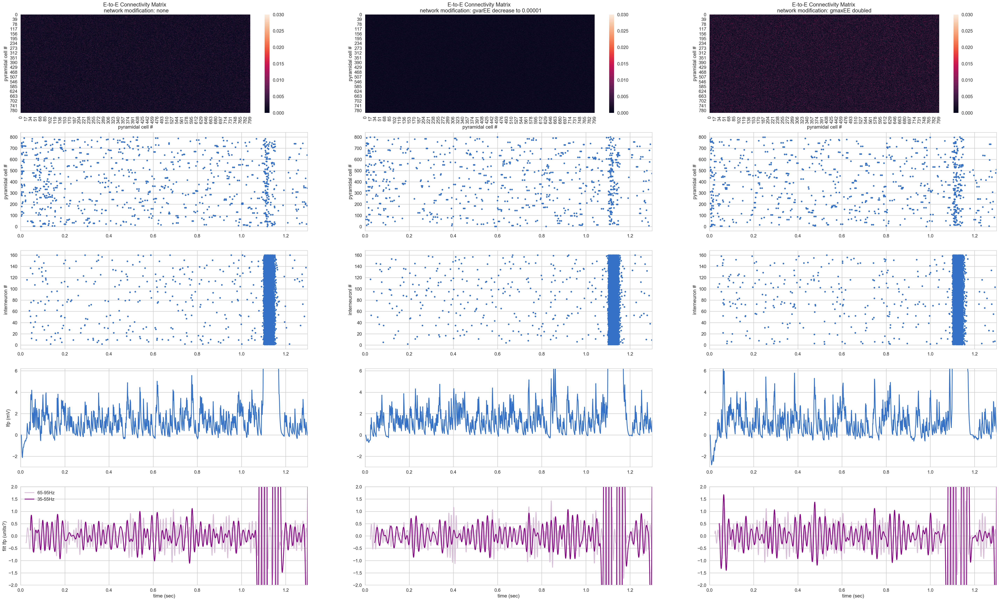

In [102]:
ts = 1.3;    # window duration

plt.figure()
plt.figure(figsize=(50,30))

# ----------------------------plot connectivity matrices----------------------------------------
plt.subplot(5,3,1)
sns.heatmap(df_conn_orig, vmin=0,vmax=.03)
plt.title('E-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(5,3,2)
sns.heatmap(df_conn_gvarEE, vmin=0,vmax=.03)
plt.title('E-to-E Connectivity Matrix \n network modification: gvarEE decrease to 0.00001')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(5,3,3)
sns.heatmap(df_conn_gmaxEE, vmin=0,vmax=.03)
plt.title('E-to-E Connectivity Matrix \n network modification: gmaxEE doubled ')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

# ----------------------------plot pyr cell rasters----------------------------------------
rescale_x = (0, ts);

df_Espktrns_partial = df_Espktrns[df_Espktrns['spktimes']<=ts]
plt.subplot(5,3,4)
plt.plot(df_Espktrns_partial['spktimes'], df_Espktrns_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)

df_Espktrns_gvarEEpoint00001_partial = df_Espktrns_gvarEEpoint00001[df_Espktrns_gvarEEpoint00001['spktimes']<=ts]
plt.subplot(5,3,5)
plt.plot(df_Espktrns_gvarEEpoint00001_partial['spktimes'], df_Espktrns_gvarEEpoint00001_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)

df_Espktrns_gmaxEEdenom5_partial = df_Espktrns_gmaxEEdenom5[df_Espktrns_gmaxEEdenom5['spktimes']<=ts]
plt.subplot(5,3,6)
plt.plot(df_Espktrns_gmaxEEdenom5_partial['spktimes'], df_Espktrns_gmaxEEdenom5_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)

# ----------------------------plot interneuron rasters--------------------------------------

df_Ispktrns_partial = df_Ispktrns[df_Ispktrns['spktimes']<=ts]
plt.subplot(5,3,7)
plt.plot(df_Ispktrns_partial['spktimes'], df_Ispktrns_partial['cell_id'],'.')
plt.ylabel('interneuron #')
plt.xlim(rescale_x)

df_Ispktrns_gvarEEpoint00001_partial = df_Ispktrns_gvarEEpoint00001[df_Ispktrns_gvarEEpoint00001['spktimes']<=ts]
plt.subplot(5,3,8)
plt.plot(df_Ispktrns_gvarEEpoint00001_partial['spktimes'], df_Ispktrns_gvarEEpoint00001_partial['cell_id'],'.')
plt.ylabel('interneuronl #')
plt.xlim(rescale_x)

df_Ispktrns_gmaxEEdenom5_partial = df_Ispktrns_gmaxEEdenom5[df_Ispktrns_gmaxEEdenom5['spktimes']<=ts]
plt.subplot(5,3,9)
plt.plot(df_Ispktrns_gmaxEEdenom5_partial['spktimes'], df_Ispktrns_gmaxEEdenom5_partial['cell_id'],'.')
plt.ylabel('interneuron #')
plt.xlim(rescale_x)

# ----------------------------plot raw lfp--------------------------------------------------
rescale_y = (-3.0, 6.2);

df_lfp_partial = df_lfp[df_lfp['time']<=ts]
plt.subplot(5,3,10)
plt.plot(df_lfp_partial['time'], df_lfp_partial['lfp'])
plt.ylabel('lfp (mV)')
plt.ylim(rescale_y)
plt.xlim(rescale_x)

df_lfp_gvarEEpoint00001_partial = df_lfp_gvarEEpoint00001[df_lfp_gvarEEpoint00001['time']<=ts]
plt.subplot(5,3,11)
plt.plot(df_lfp_gvarEEpoint00001_partial['time'],df_lfp_gvarEEpoint00001_partial['lfp'])
plt.ylim(rescale_y)
plt.xlim(rescale_x)

df_lfp_gmaxEEdenom5_partial = df_lfp_gmaxEEdenom5[df_lfp_gmaxEEdenom5['time']<=ts]
plt.subplot(5,3,12)
plt.plot(df_lfp_gmaxEEdenom5_partial['time'],df_lfp_gmaxEEdenom5_partial['lfp'])
plt.ylim(rescale_y)
plt.xlim(rescale_x)
# ----------------------------plot filtered lfp----------------------------------------------
rescale_y = (-2.0, 2.0);

plt.subplot(5,3,13)
f1 = plt.plot(df_lfp_partial['time'],df_lfp_partial['filt lfp: hi gamma'],color='thistle')
f2 = plt.plot(df_lfp_partial['time'],df_lfp_partial['filt lfp: lo gamma'],color='purple')
plt.ylabel('filt lfp (units?)')
plt.xlabel('time (sec)')
plt.legend((f1[0],f2[0]),('65-95Hz','35-55Hz'))
plt.ylim(rescale_y)
plt.xlim(rescale_x)

plt.subplot(5,3,14)
plt.plot(df_lfp_gvarEEpoint00001_partial['time'],df_lfp_gvarEEpoint00001_partial['filt lfp: hi gamma'],color='thistle')
plt.plot(df_lfp_gvarEEpoint00001_partial['time'],df_lfp_gvarEEpoint00001_partial['filt lfp: lo gamma'],color='purple')
plt.xlabel('time (sec)')
plt.ylim(rescale_y)
plt.xlim(rescale_x)

plt.subplot(5,3,15)
plt.plot(df_lfp_gmaxEEdenom5_partial['time'],df_lfp_gmaxEEdenom5_partial['filt lfp: hi gamma'],color='thistle')
plt.plot(df_lfp_gmaxEEdenom5_partial['time'],df_lfp_gmaxEEdenom5_partial['filt lfp: lo gamma'],color='purple')
plt.xlabel('time (sec)')
plt.ylim(rescale_y)
plt.xlim(rescale_x)

.
<br>
<br>
To establish a point of reference for what reasonably dense connections might be, I extract the connectivity matrices between E-to-I, I-to-I, and I-to-E from a representative simulation of the original network.
<br>
.

In [83]:
conn_origEE_etoi = orig['conn']['EtoI']
conn_origEE_itoi = orig['conn']['ItoI']
conn_origEE_itoe = orig['conn']['ItoE']

# convert the array to at least 1d (squeeze me produces 0d array)
tmp_orig_etoi = np.atleast_1d(conn_origEE_etoi) 
tmp_orig_itoi = np.atleast_1d(conn_origEE_itoi) 
tmp_orig_itoe = np.atleast_1d(conn_origEE_itoe) 

df_conn_orig_etoi = pd.DataFrame(data=tmp_orig_etoi[0]) 
df_conn_orig_itoi = pd.DataFrame(data=tmp_orig_itoi[0]) 
df_conn_orig_itoe = pd.DataFrame(data=tmp_orig_itoe[0]) 


.
<br>
<br>
The connection densities between E-to-I, I-to-I, and I-to-E in the original network are all substantially larger than E-to-E.
<br>
<br>
.

Text(0.5,28.9,'pyramidal cell #')

<Figure size 460.8x403.2 with 0 Axes>

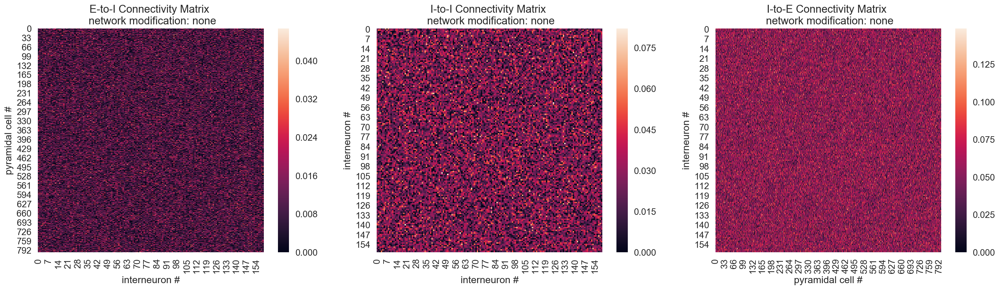

In [84]:
plt.figure()
plt.figure(figsize=(25,6))

plt.subplot(1,3,1)
sns.heatmap(df_conn_orig_etoi)
plt.title('E-to-I Connectivity Matrix \n network modification: none')
plt.ylabel('pyramidal cell #')
plt.xlabel('interneuron #')

plt.subplot(1,3,2)
sns.heatmap(df_conn_orig_itoi)
plt.title('I-to-I Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('interneuron #')

plt.subplot(1,3,3)
sns.heatmap(df_conn_orig_itoe)
plt.title('I-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('pyramidal cell #')

.
<br>
<br>
After assessing the connectivity matrices above, I will use the I-to-E In the following, I have gradually increased the peak value of the distribution of E-to-E conductances, and compare each resulting connectivity matrix against the I-to-E matrix. 
<br>
<br>
.

In [85]:
# load mat file for modified network: representative simulation of increased E-to-E gmax
sim01_gmaxEEsameasgmaxIE = sio.loadmat('sim1_connEEincrease_gmaxEEsameasgmaxIE_simdur2sec.mat',
                                       squeeze_me=True)
conn_gmaxEE_etoe2 = sim01_gmaxEEsameasgmaxIE['conn']['EtoE']
tmp_gmaxEE_etoe2 = np.atleast_1d(conn_gmaxEE_etoe2)
df_conn_gmaxEE_etoe2 = pd.DataFrame(data=tmp_gmaxEE_etoe2[0]) 

# get the raw lfp
lfp_gmaxEEsameasgmaxIE = np.atleast_1d(sim01_gmaxEEsameasgmaxIE['lfp'])

# get the filtered lfp
filt_lfp_ripple_gmaxEEsameasgmaxIE= filt.filter_signal(lfp_gmaxEEsameasgmaxIE, fs, 'bandpass',
                                                     f_range_ripple)
filt_lfp_higamma_gmaxEEsameasgmaxIE= filt.filter_signal(lfp_gmaxEEsameasgmaxIE, fs, 'bandpass', 
                                                  f_range_higamma)
filt_lfp_logamma_gmaxEEsameasgmaxIE= filt.filter_signal(lfp_gmaxEEsameasgmaxIE, fs, 'bandpass', 
                                                  f_range_logamma)

df_lfp_gmaxEEsameasgmaxIE = pd.DataFrame({'time': t,
                                    'lfp': lfp_gmaxEEsameasgmaxIE,
                                    'filt lfp: ripple': filt_lfp_ripple_gmaxEEsameasgmaxIE,
                                   'filt lfp: hi gamma': filt_lfp_higamma_gmaxEEsameasgmaxIE,
                                   'filt lfp: lo gamma': filt_lfp_logamma_gmaxEEsameasgmaxIE})

# get spiketrains
spktimes_e_gmaxEEsameasgmaxIE = np.atleast_1d(sim01_gmaxEEsameasgmaxIE['tsp_E']['times'])
cell_id_e_gmaxEEsameasgmaxIE = np.atleast_1d(sim01_gmaxEEsameasgmaxIE['tsp_E']['celln'])

spktimes_i_gmaxEEsameasgmaxIE = np.atleast_1d(sim01_gmaxEEsameasgmaxIE['tsp_I']['times'])
cell_id_i_gmaxEEsameasgmaxIE = np.atleast_1d(sim01_gmaxEEsameasgmaxIE['tsp_I']['celln'])

df_Espktrns_gmaxEEsameasgmaxIE = pd.DataFrame({'cell_id':cell_id_e_gmaxEEsameasgmaxIE[0],
               'spktimes':spktimes_e_gmaxEEsameasgmaxIE[0]})
df_Ispktrns_gmaxEEsameasgmaxIE = pd.DataFrame({'cell_id':cell_id_i_gmaxEEsameasgmaxIE[0],
               'spktimes':spktimes_i_gmaxEEsameasgmaxIE[0]})


Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz


(0, 1.3)

<Figure size 460.8x403.2 with 0 Axes>

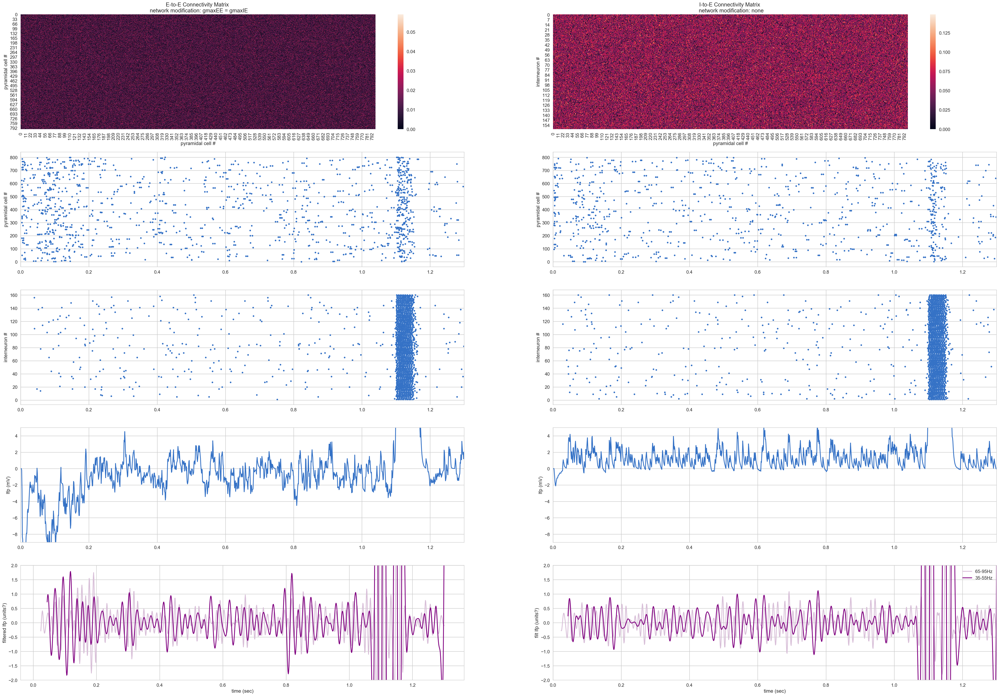

In [100]:
ts = 1.3;

plt.figure()
plt.figure(figsize=(50,35))

# ----------------------------plot connectivity matrices----------------------------------------

plt.subplot(5,2,1)
sns.heatmap(df_conn_gmaxEE_etoe2)
plt.title('E-to-E Connectivity Matrix \n network modification: gmaxEE = gmaxIE')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(5,2,2)
sns.heatmap(df_conn_orig_itoe)
plt.title('I-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('pyramidal cell #')

# ----------------------------plot pyr cell rasters----------------------------------------
rescale_x = (0, ts);

df_Espktrns_gmaxEEsameasgmaxIE_partial = df_Espktrns_gmaxEEsameasgmaxIE[df_Espktrns_gmaxEEsameasgmaxIE['spktimes']<=ts]
plt.subplot(5,2,3)
plt.plot(df_Espktrns_gmaxEEsameasgmaxIE_partial['spktimes'], df_Espktrns_gmaxEEsameasgmaxIE_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)

df_Espktrns_partial = df_Espktrns[df_Espktrns['spktimes']<=ts]
plt.subplot(5,2,4)
plt.plot(df_Espktrns_partial['spktimes'], df_Espktrns_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)

# ----------------------------plot interneuron rasters--------------------------------------

df_Ispktrns_gmaxEEsameasgmaxIE_partial = df_Ispktrns_gmaxEEsameasgmaxIE[df_Ispktrns_gmaxEEsameasgmaxIE['spktimes']<=ts]
plt.subplot(5,2,5)
plt.plot(df_Ispktrns_gmaxEEsameasgmaxIE_partial['spktimes'], df_Ispktrns_gmaxEEsameasgmaxIE_partial['cell_id'],'.')
plt.ylabel('interneuron #')
plt.xlim(rescale_x)

df_Ispktrns_partial = df_Ispktrns[df_Ispktrns['spktimes']<=ts]
plt.subplot(5,2,6)
plt.plot(df_Ispktrns_partial['spktimes'], df_Ispktrns_partial['cell_id'],'.')
plt.ylabel('interneuron #')
plt.xlim(rescale_x)

# ----------------------------plot raw lfp--------------------------------------------------
rescale_y = (-9.0, 5.0);

df_lfp_gmaxEEsameasgmaxIE_partial = df_lfp_gmaxEEsameasgmaxIE[df_lfp_gmaxEEsameasgmaxIE['time']<=ts]
plt.subplot(5,2,7)
plt.plot(df_lfp_gmaxEEsameasgmaxIE_partial['time'], df_lfp_gmaxEEsameasgmaxIE_partial['lfp'])
plt.ylabel('lfp (mV)')
plt.ylim(rescale_y)
plt.xlim(rescale_x)

df_lfp_partial = df_lfp[df_lfp['time']<=ts]
plt.subplot(5,2,8)
plt.plot(df_lfp_partial['time'], df_lfp_partial['lfp'])
plt.ylabel('lfp (mV)')
plt.ylim(rescale_y)
plt.xlim(rescale_x)

# ----------------------------plot filtered lfps--------------------------------------------------
rescale_y = (-2.0, 2.0);

plt.subplot(5,2,9)
plt.plot(df_lfp_gmaxEEsameasgmaxIE_partial['time'], df_lfp_gmaxEEsameasgmaxIE_partial['filt lfp: hi gamma'],color='thistle')
plt.plot(df_lfp_gmaxEEsameasgmaxIE_partial['time'],df_lfp_gmaxEEsameasgmaxIE_partial['filt lfp: lo gamma'],color='purple')
plt.ylabel('filtered lfp (units?)')
plt.xlabel('time (sec)')
plt.ylim(rescale_y)

plt.subplot(5,2,10)
f1 = plt.plot(df_lfp_partial['time'],df_lfp_partial['filt lfp: hi gamma'],color='thistle')
f2 = plt.plot(df_lfp_partial['time'],df_lfp_partial['filt lfp: lo gamma'],color='purple')
plt.ylabel('filt lfp (units?)')
plt.xlabel('time (sec)')
plt.legend((f1[0],f2[0]),('65-95Hz','35-55Hz'))
plt.ylim(rescale_y)
plt.xlim(rescale_x)

In [103]:
# load mat file for modified network: representative simulation of increased E-to-E gmax
sim01_gmaxEEsameasgmaxIEtimes4 = sio.loadmat('sim1_connEEincrease_gmaxEEsameasgmaxIEtimes4_simdur2sec.mat',
                                                  squeeze_me=True)
conn_gmaxEE_etoe3 = sim01_gmaxEEsameasgmaxIEtimes4['conn']['EtoE']
tmp_gmaxEE_etoe3 = np.atleast_1d(conn_gmaxEE_etoe3)
df_conn_gmaxEE_etoe3 = pd.DataFrame(data=tmp_gmaxEE_etoe3[0]) 

# get the raw lfp
lfp_gmaxEEsameasgmaxIEtimes4 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes4['lfp'])

# get the filtered lfp
filt_lfp_ripple_gmaxEEsameasgmaxIEtimes4= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes4, fs, 'bandpass',
                                                     f_range_ripple)
filt_lfp_higamma_gmaxEEsameasgmaxIEtimes4= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes4, fs, 'bandpass', 
                                                  f_range_higamma)
filt_lfp_logamma_gmaxEEsameasgmaxIEtimes4= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes4, fs, 'bandpass', 
                                                  f_range_logamma)

df_lfp_gmaxEEsameasgmaxIEtimes4 = pd.DataFrame({'time': t,
                                    'lfp': lfp_gmaxEEsameasgmaxIEtimes4,
                                    'filt lfp: ripple': filt_lfp_ripple_gmaxEEsameasgmaxIEtimes4,
                                   'filt lfp: hi gamma': filt_lfp_higamma_gmaxEEsameasgmaxIEtimes4,
                                   'filt lfp: lo gamma': filt_lfp_logamma_gmaxEEsameasgmaxIEtimes4})

# get spiketrains
spktimes_e_gmaxEEsameasgmaxIEtimes4 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes4['tsp_E']['times'])
cell_id_e_gmaxEEsameasgmaxIEtimes4 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes4['tsp_E']['celln'])

spktimes_i_gmaxEEsameasgmaxIEtimes4 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes4['tsp_I']['times'])
cell_id_i_gmaxEEsameasgmaxIEtimes4 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes4['tsp_I']['celln'])

df_Espktrns_gmaxEEsameasgmaxIEtimes4 = pd.DataFrame({'cell_id':cell_id_e_gmaxEEsameasgmaxIEtimes4[0],
               'spktimes':spktimes_e_gmaxEEsameasgmaxIEtimes4[0]})
df_Ispktrns_gmaxEEsameasgmaxIEtimes4 = pd.DataFrame({'cell_id':cell_id_i_gmaxEEsameasgmaxIEtimes4[0],
               'spktimes':spktimes_i_gmaxEEsameasgmaxIEtimes4[0]})




Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz


.
<br>
<br>
Changing the E-to-E mean conductance to match that of the I-to-E made the dynamics crazy! Hugely synchronous bouts of spontaneous excitatory activity.
<br>
<br>
.

<Figure size 460.8x403.2 with 0 Axes>

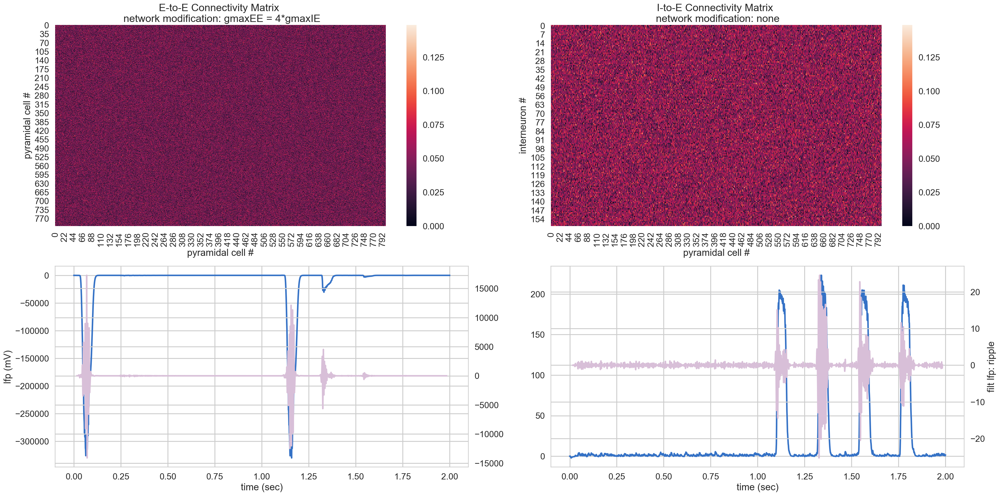

In [48]:
ts = 1.3;

plt.figure()
plt.figure(figsize=(50,35))

# ----------------------------plot connectivity matrices----------------------------------------

plt.subplot(5,2,1)
sns.heatmap(df_conn_gmaxEE_etoe3)
plt.title('E-to-E Connectivity Matrix \n network modification: gmaxEE = 4*gmaxIE')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(5,2,2)
sns.heatmap(df_conn_orig_itoe)
plt.title('I-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('pyramidal cell #')

# ----------------------------plot pyr cell rasters----------------------------------------
rescale_x = (0, ts);
df_Espktrns_partial = df_Espktrns[df_Espktrns['spktimes']<=ts]
plt.subplot(5,2,4)
plt.plot(df_Espktrns_partial['spktimes'], df_Espktrns_partial['cell_id'],'.')
plt.ylabel('pyramidal cell #')
plt.xlim(rescale_x)



ax1 = plt.subplot(2,2,3)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes4['time'], df_lfp_gmaxEEsameasgmaxIEtimes4['lfp'])
plt.ylabel('lfp (mV)')
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes4['time'],df_lfp_gmaxEEsameasgmaxIEtimes4['filt lfp: ripple'],color='thistle')

ax1 = plt.subplot(2,2,4)
plt.plot(df_lfp['time'], df_lfp['lfp'])
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: ripple')  # we already handled the x-label with ax1
ax2.plot(df_lfp['time'],df_lfp['filt lfp: ripple'],color='thistle')

In [49]:
# load mat file for modified network: representative simulation of increased E-to-E gmax
sim01_gmaxEEsameasgmaxIEtimes2 = sio.loadmat('sim1_connEEincrease_gmaxEEsameasgmaxIEtimes2_simdur2sec.mat',
                                                  squeeze_me=True)
conn_gmaxEE_etoe4 = sim01_gmaxEEsameasgmaxIEtimes2['conn']['EtoE']
tmp_gmaxEE_etoe4 = np.atleast_1d(conn_gmaxEE_etoe4)
df_conn_gmaxEE_etoe4 = pd.DataFrame(data=tmp_gmaxEE_etoe4[0]) 

# get the raw lfp
lfp_gmaxEEsameasgmaxIEtimes2 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes2['lfp'])

# get the filtered lfp
filt_lfp_ripple_gmaxEEsameasgmaxIEtimes2= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes2, fs, 'bandpass',
                                                     f_range_ripple)

df_lfp_gmaxEEsameasgmaxIEtimes2 = pd.DataFrame({'time': t,
                                    'lfp': lfp_gmaxEEsameasgmaxIEtimes2,
                                    'filt lfp: ripple': filt_lfp_ripple_gmaxEEsameasgmaxIEtimes2})



Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz


<Figure size 460.8x403.2 with 0 Axes>

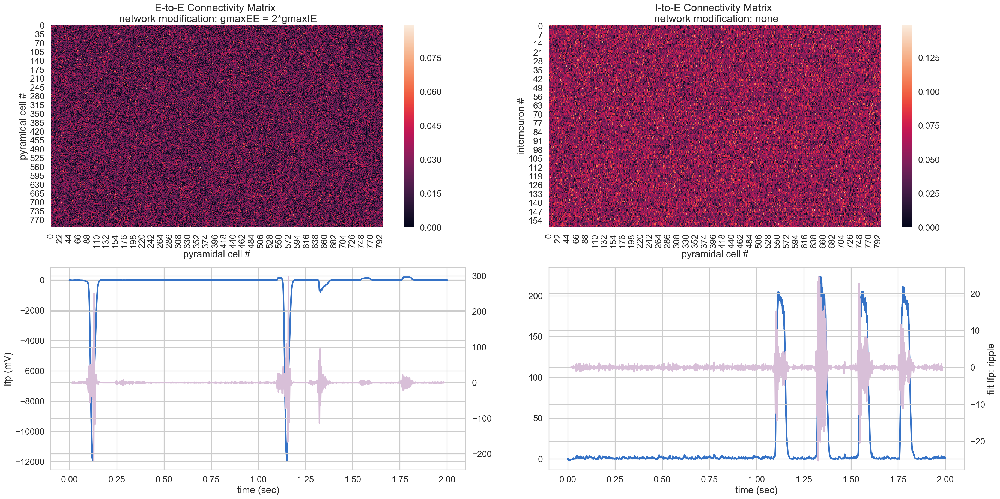

In [50]:
plt.figure()
plt.figure(figsize=(30,15))

plt.subplot(2,2,1)
sns.heatmap(df_conn_gmaxEE_etoe4)
plt.title('E-to-E Connectivity Matrix \n network modification: gmaxEE = 2*gmaxIE')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(2,2,2)
sns.heatmap(df_conn_orig_itoe)
plt.title('I-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('pyramidal cell #')

ax1 = plt.subplot(2,2,3)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes2['time'], df_lfp_gmaxEEsameasgmaxIEtimes2['lfp'])
plt.ylabel('lfp (mV)')
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes2['time'],df_lfp_gmaxEEsameasgmaxIEtimes2['filt lfp: ripple'],color='thistle')

ax1 = plt.subplot(2,2,4)
plt.plot(df_lfp['time'], df_lfp['lfp'])
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: ripple')  # we already handled the x-label with ax1
ax2.plot(df_lfp['time'],df_lfp['filt lfp: ripple'],color='thistle')

In [51]:
# load mat file for modified network: representative simulation of increased E-to-E gmax
sim01_gmaxEEsameasgmaxIEtimes1point5 = sio.loadmat('sim1_connEEincrease_gmaxEEsameasgmaxIEtimes1point5_simdur2sec.mat',
                                                        squeeze_me=True)
conn_gmaxEE_etoe5 = sim01_gmaxEEsameasgmaxIEtimes1point5['conn']['EtoE']
tmp_gmaxEE_etoe5 = np.atleast_1d(conn_gmaxEE_etoe5)
df_conn_gmaxEE_etoe5 = pd.DataFrame(data=tmp_gmaxEE_etoe5[0]) 

# get the raw lfp
lfp_gmaxEEsameasgmaxIEtimes1point5 = np.atleast_1d(sim01_gmaxEEsameasgmaxIEtimes1point5['lfp'])

# get the filtered lfp
filt_lfp_ripple_gmaxEEsameasgmaxIEtimes1point5= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes1point5, fs, 'bandpass',
                                                     f_range_ripple)
filt_lfp_higamma_gmaxEEsameasgmaxIEtimes1point5= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes1point5, fs, 'bandpass',
                                                     f_range_higamma)
filt_lfp_logamma_gmaxEEsameasgmaxIEtimes1point5= filt.filter_signal(lfp_gmaxEEsameasgmaxIEtimes1point5, fs, 'bandpass',
                                                     f_range_logamma)

df_lfp_gmaxEEsameasgmaxIEtimes1point5 = pd.DataFrame({'time': t,
                                        'lfp': lfp_gmaxEEsameasgmaxIEtimes1point5,
                                        'filt lfp: ripple': filt_lfp_ripple_gmaxEEsameasgmaxIEtimes1point5,
                                        'filt lfp: hi gamma': filt_lfp_higamma_gmaxEEsameasgmaxIEtimes1point5,
                                        'filt lfp: lo gamma': filt_lfp_logamma_gmaxEEsameasgmaxIEtimes1point5})


Transition bandwidth is 43.9 Hz. Pass/stop bandwidth is 200 Hz
Transition bandwidth is 21.5 Hz. Pass/stop bandwidth is 30 Hz
Transition bandwidth is 12.7 Hz. Pass/stop bandwidth is 20 Hz


<Figure size 460.8x403.2 with 0 Axes>

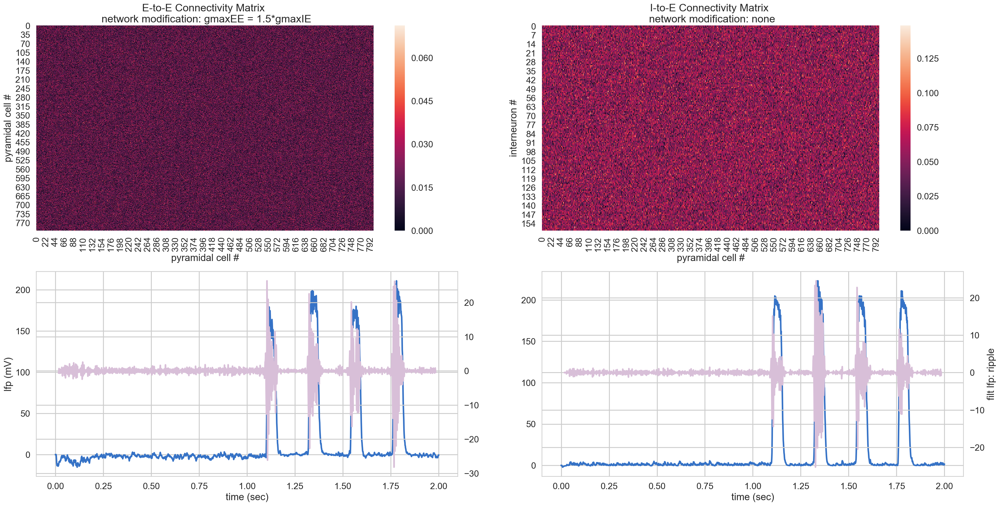

In [52]:
plt.figure()
plt.figure(figsize=(30,15))

plt.subplot(2,2,1)
sns.heatmap(df_conn_gmaxEE_etoe5)
plt.title('E-to-E Connectivity Matrix \n network modification: gmaxEE = 1.5*gmaxIE')
plt.ylabel('pyramidal cell #')
plt.xlabel('pyramidal cell #')

plt.subplot(2,2,2)
sns.heatmap(df_conn_orig_itoe)
plt.title('I-to-E Connectivity Matrix \n network modification: none')
plt.ylabel('interneuron #')
plt.xlabel('pyramidal cell #')

ax1 = plt.subplot(2,2,3)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'], df_lfp_gmaxEEsameasgmaxIEtimes1point5['lfp'])
plt.ylabel('lfp (mV)')
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'],df_lfp_gmaxEEsameasgmaxIEtimes1point5['filt lfp: ripple'],color='thistle')

ax1 = plt.subplot(2,2,4)
plt.plot(df_lfp['time'], df_lfp['lfp'])
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: ripple')  # we already handled the x-label with ax1
ax2.plot(df_lfp['time'],df_lfp['filt lfp: ripple'],color='thistle')

.
<br>
<br>
The raw LFP in the first second of the modified network above appears, by eye, to have slightly higher-amplitude fast frequencies than the first second of simulation in the original network. To check whether there are any other high-frequency components, I have filtered the signals below into ripple frequency, high gamma, and low gamma, and compared them visually against the same bands in the original network. 
<br>
<br>
.

<Figure size 460.8x403.2 with 0 Axes>

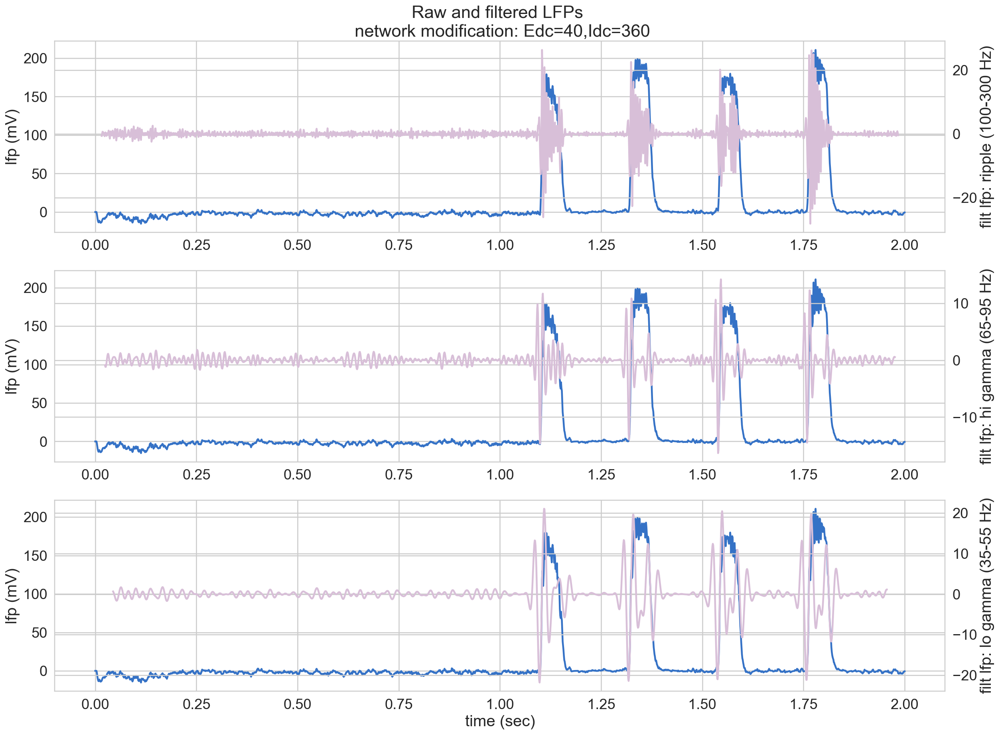

In [54]:
plt.figure()
plt.figure(figsize=(20,15))
sns.set_context("talk", font_scale=1.4)

ax1 = plt.subplot(3,1,1)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'], df_lfp_gmaxEEsameasgmaxIEtimes1point5['lfp'])
plt.ylabel('lfp (mV)')
plt.title('Raw and filtered LFPs \n network modification: Edc=40,Idc=360')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: ripple (100-300 Hz)')  # we already handled the x-label with ax1
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'],df_lfp_gmaxEEsameasgmaxIEtimes1point5['filt lfp: ripple'],color='thistle')

ax1 = plt.subplot(3,1,2)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'], df_lfp_gmaxEEsameasgmaxIEtimes1point5['lfp'])
plt.ylabel('lfp (mV)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: hi gamma (65-95 Hz)')  # we already handled the x-label with ax1
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'],df_lfp_gmaxEEsameasgmaxIEtimes1point5['filt lfp: hi gamma'],color='thistle')

ax1 = plt.subplot(3,1,3)
plt.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'], df_lfp_gmaxEEsameasgmaxIEtimes1point5['lfp'])
plt.ylabel('lfp (mV)')
plt.xlabel('time (sec)')
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.set_ylabel('filt lfp: lo gamma (35-55 Hz)')  # we already handled the x-label with ax1
ax2.plot(df_lfp_gmaxEEsameasgmaxIEtimes1point5['time'],df_lfp_gmaxEEsameasgmaxIEtimes1point5['filt lfp: lo gamma'],color='thistle')



.
<br>
<br>
This first pass suggests that it might not be sufficient to exclusively change the E-to-E connectivity to generate the weak PING. 
<br>
<br>
.